In [1]:
import cv2 as cv
import os
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import tqdm

In [27]:
BLUR_BODY_DATA_PATH = "data/BlurBody" 
IRONMAN_DATA_PATH = "data/Ironman" 
DOG_DATA_PATH = "data/Dog" 
SURFER_DATA_PATH = "data/Surfer" 
WALKING_DATA_PATH = "data/Walking" 


In [40]:
def read_data(data_path, sep='\t'):
    boxes = pd.read_csv(f"{data_path}/groundtruth_rect.txt", sep=sep, header=None)
    frames = list(sorted(os.listdir(f"{data_path}/img/")))
    return frames, boxes 

In [29]:
def calculate_roi_hist(roi):
    hsv_roi =  cv.cvtColor(roi, cv.COLOR_BGR2HSV)
    mask = cv.inRange(hsv_roi, np.array((0., 60.,32.)), np.array((180.,255.,255.)))
    roi_hist = cv.calcHist([hsv_roi],[0],mask,[180],[0,180])
    cv.normalize(roi_hist,roi_hist,0,255,cv.NORM_MINMAX)
    return roi_hist

def calculate_updated_window_position(image, window, roi_hist, method='meanshift'):
    term_crit = ( cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 1 )
    
    hsv = cv.cvtColor(image, cv.COLOR_BGR2HSV)
    dst = cv.calcBackProject([hsv],[0],roi_hist,[0,180],1)
    # apply meanshift to get the new location
    if method == 'meanshift':
        ret, window = cv.meanShift(dst, window, term_crit)
    elif method == 'camshift':
        ret, window = cv.CamShift(dst, window, term_crit)
    else:
        raise NotImplemented("\shrug")
        
    return ret, window

def plot_meanshift_results(image, window):
    x,y,w,h = window
    img2 = cv.rectangle(image, (x,y), (x+w,y+h), 255,2)
    plt.imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB))

def plot_camshift_results(image, ret):
    pts = cv.boxPoints(ret)
    pts = np.int0(pts)
    img2 = cv.polylines(image,[pts],True, 255,2)
    plt.imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB))
    
def open_cv_tracker(frames_path, frames, window_init, method='meanshift'):
    x,y,w,h = window = window_init
    image = cv.imread(f"{frames_path}/img/{frames[0]}")
    roi = image[y:y+h, x:x+w]
    roi_hist = calculate_roi_hist(roi)
    
    # Pyplot configuration
    frames_total = len(frames)
    plt.figure(figsize=(18, int(frames_total * 1.4)))
    
    for i, frame_name in enumerate(tqdm.tqdm_notebook(frames[1:])):
        image = cv.imread(f"{frames_path}/img/{frame_name}")
        ret, window = calculate_updated_window_position(image, window, roi_hist, method=method)

        # Draw and plot
        plt.subplot((frames_total // 3) + 2, 3, i+1)
        if method == 'meanshift':
            plot_meanshift_results(image, window)
        elif method == 'camshift':
            plot_camshift_results(image, ret)
            


-==========- Meanshift -==========-


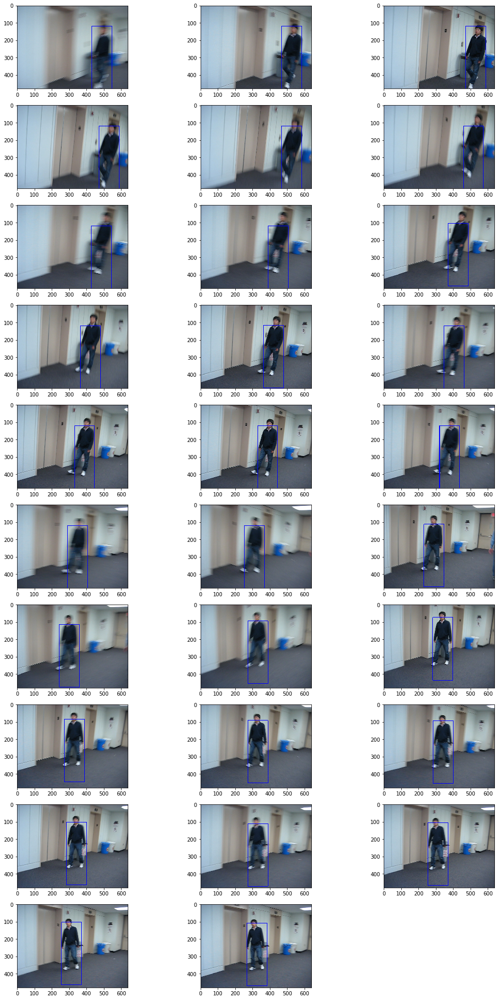

-==========- CAMSHIFT -==========-


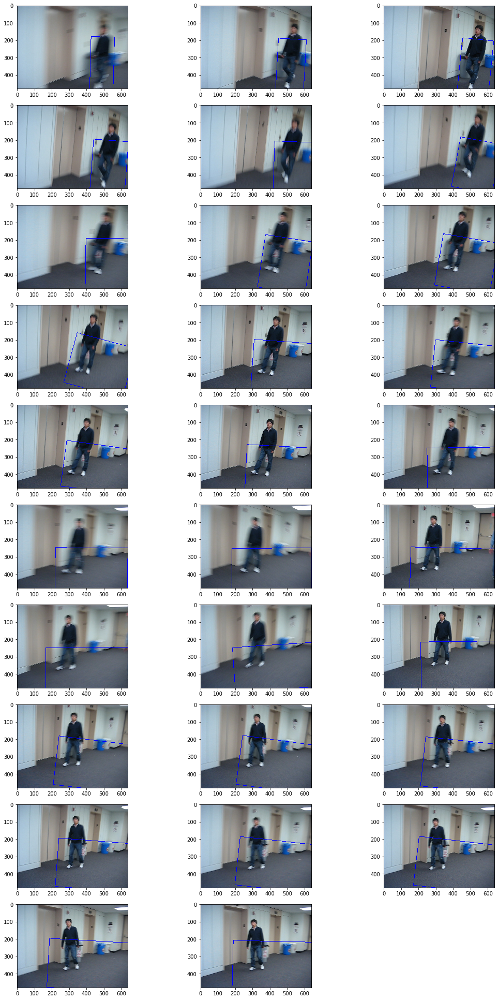

In [32]:
DATA_PATH = BLUR_BODY_DATA_PATH
frames, boxes = read_data(DATA_PATH)
start_index = 50
sequence_len = 30
x, y, w, h = boxes.iloc[start_index]
print("-==========- Meanshift -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='meanshift')
plt.show()
print("-==========- CAMSHIFT -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='camshift')
plt.show()

-==========- Meanshift -==========-


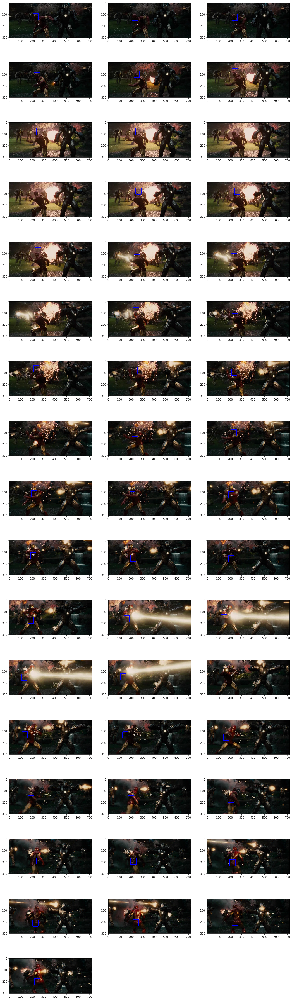

-==========- CAMSHIFT -==========-


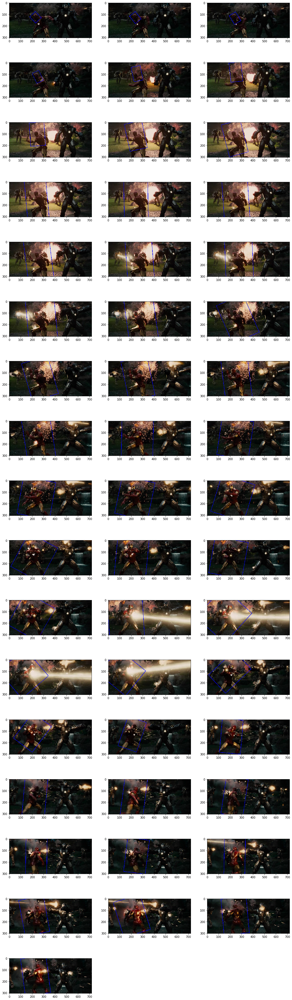

In [42]:
DATA_PATH = IRONMAN_DATA_PATH
frames, boxes = read_data(DATA_PATH, sep=',')
start_index = 0
sequence_len = 50
x, y, w, h = boxes.iloc[start_index]
print("-==========- Meanshift -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='meanshift')
plt.show()
print("-==========- CAMSHIFT -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='camshift')
plt.show()

-==========- Meanshift -==========-


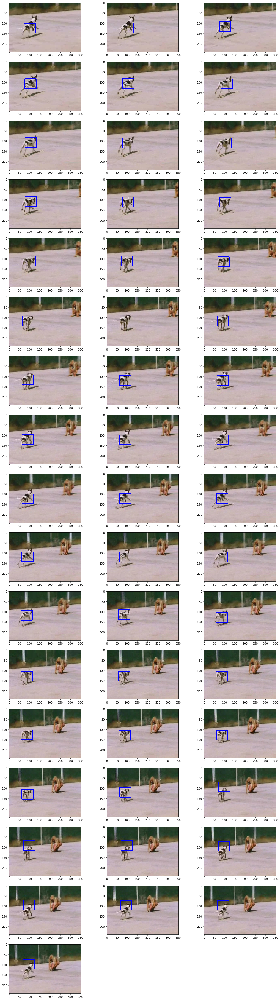

-==========- CAMSHIFT -==========-


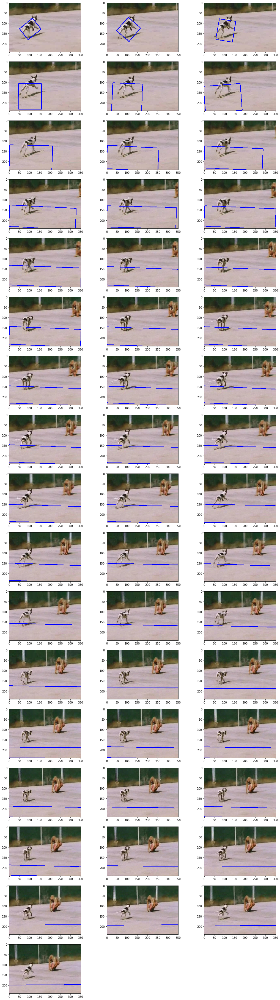

In [44]:
DATA_PATH = DOG_DATA_PATH
frames, boxes = read_data(DATA_PATH, sep='\t')
start_index = 0
sequence_len = 50
x, y, w, h = boxes.iloc[start_index]
print("-==========- Meanshift -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='meanshift')
plt.show()
print("-==========- CAMSHIFT -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='camshift')
plt.show()

-==========- Meanshift -==========-


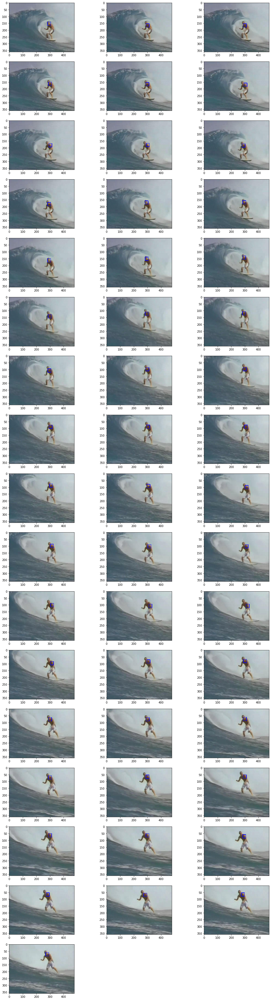

-==========- CAMSHIFT -==========-


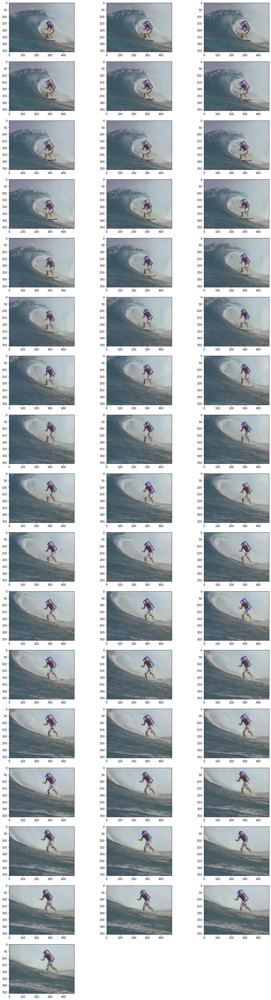

In [45]:
DATA_PATH = SURFER_DATA_PATH
frames, boxes = read_data(DATA_PATH, sep='\t')
start_index = 0
sequence_len = 50
x, y, w, h = boxes.iloc[start_index]
print("-==========- Meanshift -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='meanshift')
plt.show()
print("-==========- CAMSHIFT -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='camshift')
plt.show()

-==========- Meanshift -==========-


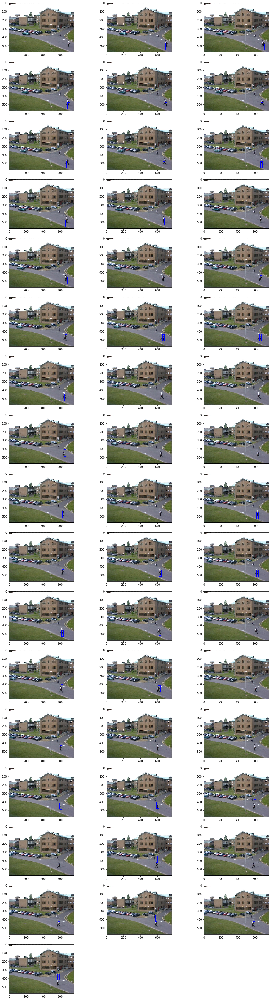

-==========- CAMSHIFT -==========-


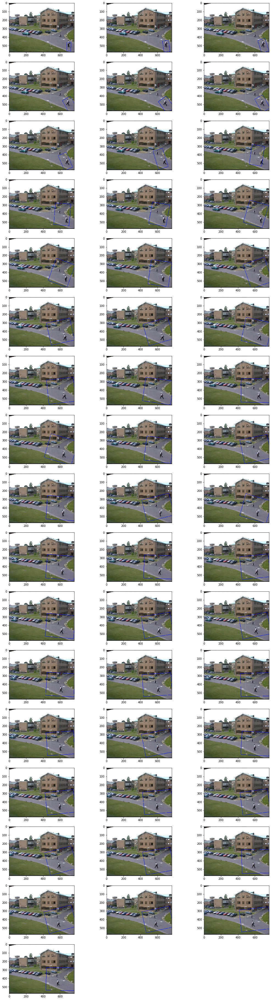

In [46]:
DATA_PATH = WALKING_DATA_PATH
frames, boxes = read_data(DATA_PATH, sep='\t')
start_index = 0
sequence_len = 50
x, y, w, h = boxes.iloc[start_index]
print("-==========- Meanshift -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='meanshift')
plt.show()
print("-==========- CAMSHIFT -==========-")
open_cv_tracker(DATA_PATH, frames[start_index:start_index + sequence_len], (x, y, w, h), method='camshift')
plt.show()